**Import**

In [ ]:
!pip install SimpleITK
!pip install voxelmorph
!pip install volumentations-3D

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 48.4 MB 1.9 MB/s 
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 54 kB 1.9 MB/s 
     |████████████████████████████████| 108 kB 43.6 MB/s 
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
from google.colab import drive
import os
drive.mount('/content/drive')

import os, sys
import random
import numpy as np
import tensorflow as tf
assert tf.__version__.startswith('2.')
# tf.compat.v1.disable_eager_execution()
import voxelmorph as vxm
import neurite as ne
import volumentations as V
import SimpleITK as sitk
import matplotlib.pyplot as plt
import plotly.graph_objects as go
import plotly.io as pio
pio.renderers.default = 'colab'

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
os.chdir('/content/drive/MyDrive/Voxelmorph_training/data/')
model_dir = '/content/drive/MyDrive/Voxelmorph_training/models/'

In [ ]:
def predict(shape = (256, 256, 416)): # ONLY GPU
  global input
  print(f'size: {shape}')
  model = vxm.networks.VxmDenseSemiSupervisedSeg(
    inshape = (256, 256, 416),
    nb_labels = 1,
    nb_unet_features=[
                      [16, 32, 32, 32],
                      [32, 32, 32, 32, 32, 16, 16]
                     ],
    int_steps = 7,
    int_resolution = 1,
    seg_resolution = 1
  )
  model.load_weights('/content/drive/MyDrive/Voxelmorph_training/models/brain_3d.h5')
  mov_img_path = input('Path to moving img: ')
  fix_img_path = input('Path to fixed img: ')
  mov_seg_path = input('Path to moving seg: ')

  mov_img = sitk.ReadImage(mov_img_path)
  fix_img = sitk.ReadImage(fix_img_path)
  mov_seg = sitk.ReadImage(mov_seg_path)

  mov_img = sitk.GetArrayFromImage(mov_img)
  fix_img = sitk.GetArrayFromImage(fix_img)
  mov_seg = sitk.GetArrayFromImage(mov_seg)
  print(f'Shapes:\nmoving img: {mov_img.shape}\nfixed img: {fix_img.shape}\nmoving seg: {mov_seg.shape}')

  mov_img -= mov_img.min() # preprocess
  fix_img -= fix_img.min()
  mov_img = mov_img.astype('float32') / mov_img.max()
  fix_img = fix_img.astype('float32') / fix_img.max()

  mov_seg[mov_seg > .5] = 1 # only 1 label

  mov_img = mov_img[np.newaxis, :256, :256, :416, np.newaxis]
  fix_img = fix_img[np.newaxis, :256, :256, :416, np.newaxis]
  mov_seg = mov_seg[np.newaxis, :256, :256, :416, np.newaxis]

  input = [mov_img, fix_img, mov_seg]
  print('Return list: [moved img, warp field, moved seg]')
  return model.predict([mov_img, fix_img, mov_seg])

In [ ]:
def dice_score(moving, moved, fixed): # label
  if moved.ndim > 3:
    moved = [0, ..., 0]
  if fixed.ndim > 3:
    fixed = [0, ..., 0]
  if moving.ndim > 3:
    moving = [0, ..., 0]
  dice1 = 2 * (np.round(moving) * np.round(fixed)).sum() / (np.round(moving).sum() + np.round(fixed).sum())
  dice2 = 2 * (np.round(moved) * np.round(fixed)).sum() / (np.round(moved).sum() + np.round(fixed).sum())
  print(f'Dice before deformation: {np.round(dice1, 4)} (moving & fixed)')
  print(f'Dice after deformation: {np.round(dice2, 4)} (moved & fixed)')
  return

In [ ]:
def MSE(moving, moved, fixed): # atlas
  if moved.ndim > 3:
    moved = [0, ..., 0]
  if fixed.ndim > 3:
    fixed = [0, ..., 0]
  if moving.ndim > 3:
    moving = [0, ..., 0]
  
  plt.figure(figsize=(20, 10))
  plt.title('MSE')
  plt.hist(np.pow((moving - fixed), 2).flatten(), bins = 'rice', label='moving-fixed', alpha=0.5, color='r')
  plt.hist(np.pow((moved - fixed), 2).flatten(), bins = 'rice', label='moved-fixed', alpha=0.5, color='r')
  plt.show()

In [ ]:
def use_warp(moving, warp):
  url = 'https://github.com/voxelmorph/voxelmorph/blob/dev/scripts/tf/warp.py'
  pass

In [ ]:
# def generator():
#   img_m = sitk.ReadImage('/content/drive/MyDrive/patient_0/img_first.nii.gz')
#   img_m = sitk.GetArrayFromImage(img_m)
#   img_m = img_m[np.newaxis, 934:1126, 100:228, 150:310, np.newaxis]
#   mi, ma = img_m.min(), img_m.max()
#   img_m = (img_m.astype('float32') - mi) / ma
  

#   seg_m = sitk.ReadImage('/content/drive/MyDrive/patient_0/label_1.nii.gz')
#   seg_m = sitk.GetArrayFromImage(seg_m)
#   seg_m[seg_m > 1] = 1
#   seg_m = seg_m[np.newaxis, 934:1126, 100:228, 150:310, np.newaxis].astype('float32')

#   img_f = sitk.ReadImage('/content/drive/MyDrive/patient_0/img_second.nii.gz')
#   img_f = sitk.GetArrayFromImage(img_f)
#   img_f = img_f[np.newaxis, 1199:1391, 100:228, 150:310, np.newaxis]
#   mi, ma = img_f.min(), img_f.max()
#   img_f = (img_f.astype('float32') - mi) / ma

#   seg_f = sitk.ReadImage('/content/drive/MyDrive/patient_0/label_2.nii.gz')
#   seg_f = sitk.GetArrayFromImage(seg_f)
#   seg_f[seg_f > 1] = 1
#   seg_f = seg_f[np.newaxis, 1199:1391, 100:228, 150:310, np.newaxis].astype('float32')

#   while True:
#     yield ([img_m, img_f, seg_m], [img_f, np.zeros((1, 192, 128, 160, 3)), seg_f])

# gen = generator()

In [ ]:
def example_gen():
  img_fixed = sitk.ReadImage('/content/drive/MyDrive/patient_0/example/img_aug.nii.gz')
  img_fixed = sitk.GetArrayFromImage(img_fixed)[np.newaxis, 4:196, 73:233, 170:298, np.newaxis]
  img_fixed = img_fixed - img_fixed.min()
  img_fixed = img_fixed.astype('float32') / img_fixed.max()

  img_moving = sitk.ReadImage('/content/drive/MyDrive/patient_0/example/img_orig.nii.gz')
  img_moving = sitk.GetArrayFromImage(img_moving)[np.newaxis, 4:196, 73:233, 170:298, np.newaxis]
  img_moving = img_moving - img_moving.min()
  img_moving = img_moving.astype('float32') / img_moving.max()

  seg_fixed = sitk.ReadImage('/content/drive/MyDrive/patient_0/example/seg_aug.nii.gz')
  seg_fixed = sitk.GetArrayFromImage(seg_fixed)[np.newaxis, 4:196, 73:233, 170:298, np.newaxis]
  seg_fixed[seg_fixed > 0] = 1
  seg_fixed = seg_fixed.astype('float32')

  seg_moving = sitk.ReadImage('/content/drive/MyDrive/patient_0/example/seg_orig.nii.gz')
  seg_moving = sitk.GetArrayFromImage(seg_moving)[np.newaxis, 4:196, 73:233, 170:298, np.newaxis]
  seg_moving[seg_moving > 0] = 1
  seg_moving = seg_moving.astype('float32')

  while True:
    yield ([img_moving, img_fixed, seg_moving], [img_fixed, seg_fixed])

exgen = example_gen()

In [ ]:
def generator(sq_size=64):
  # output: (involvs, outvolvs)
  # involvs = [moving_vol, fixed_vol, moving_seg]
  # outvolvs = [fixed_vol, zeros, fixed_seg]
  while True:
    involvs = [np.random.randn(1, 256, 256, 416, 1) for i in range(3)]
    outvolvs = [np.random.randn(1, 160, 224, 160, 1) for i in range(3)]
    yield (involvs, outvolvs)

gen = generator()

In [ ]:
врjgам

In [ ]:
# TESTING
model = vxm.networks.VxmDenseSemiSupervisedSeg( #
    inshape = (256, 256, 416), # only gpu
    nb_labels = 1,
    nb_unet_features=[
                      [16, 32, 32, 32],
                      [32, 32, 32, 32, 32, 16, 16]
                     ],
    int_steps = 7,
    int_resolution = 1,
    seg_resolution = 1
)
# 256 x 256 x 416
print('input shape: ', ', '.join([str(t.shape) for t in model.inputs]))
print('output shape:', ', '.join([str(t.shape) for t in model.outputs]))

input shape:  (None, 256, 256, 416, 1), (None, 256, 256, 416, 1), (None, 256, 256, 416, 1)
output shape: (None, 256, 256, 416, 1), (None, 256, 256, 416, 3), (None, 256, 256, 416, 1)


In [ ]:
model = vxm.networks.VxmDenseSemiSupervisedSeg( #
    inshape = (192, 160, 128),
    nb_labels = 1,
    nb_unet_features=[
                      [16, 32, 32, 32],
                      [32, 32, 32, 32, 32, 16, 16]
                     ],
    int_steps = 7,
    int_resolution = 1,
    seg_resolution = 1
)
156 x 199 x 144
print('input shape: ', ', '.join([str(t.shape) for t in model.inputs]))
print('output shape:', ', '.join([str(t.shape) for t in model.outputs]))

SyntaxError: ignored

In [ ]:
image_loss_func = vxm.losses.MSE().loss

losses = [vxm.losses.MSE().loss,
          vxm.losses.Grad('l2', loss_mult=1).loss,
          vxm.losses.Dice().loss]

weights = [1, .01, .05] # HYPERPARAMS

In [ ]:
#gpu = 1
#device, nb_devices = vxm.tf.utils.setup_device(gpu)

save_filename = os.path.join(model_dir, '{epoch:04d}.h5')
save_callback = tf.keras.callbacks.ModelCheckpoint(save_filename, save_freq = 'epoch')

model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=1e-3), loss=losses, loss_weights=weights)

model.load_weights('/content/drive/MyDrive/Voxelmorph_training/models/brain_3d.h5')
# model.save(save_filename.format(epoch=0))
# model.load_weights('/content/drive/MyDrive/Voxelmorph_training/models/0000.h5')

In [ ]:
initial_epoch=0

loss_history = model.fit_generator(gen,
                    initial_epoch=initial_epoch,
                    epochs = 5,
                    steps_per_epoch = 15,
                    callbacks=[save_callback],
                    verbose=1)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: UserWarning:

`Model.fit_generator` is deprecated and will be removed in a future version. Please use `Model.fit`, which supports generators.



Epoch 1/5


**Using**

In [ ]:
def val_gen():
    # involvs = [moving_vol, fixed_vol, moving_seg]
  img_m = sitk.ReadImage('/content/drive/MyDrive/patient_0/img_first.nii.gz')
  img_m = sitk.GetArrayFromImage(img_m)
  img_m = img_m[np.newaxis, 934:1126, 100:228, 150:310, np.newaxis]
  mi, ma = img_m.min(), img_m.max()
  img_m = (img_m.astype('float32') - mi) / ma
  

  seg_m = sitk.ReadImage('/content/drive/MyDrive/patient_0/label_1.nii.gz')
  seg_m = sitk.GetArrayFromImage(seg_m)
  seg_m[seg_m > 1] = 1
  seg_m = seg_m[np.newaxis, 934:1126, 100:228, 150:310, np.newaxis].astype('float32')

  img_f = sitk.ReadImage('/content/drive/MyDrive/patient_0/img_second.nii.gz')
  img_f = sitk.GetArrayFromImage(img_f)
  img_f = img_f[np.newaxis, 1199:1391, 100:228, 150:310, np.newaxis]
  mi, ma = img_f.min(), img_f.max()
  img_f = (img_f.astype('float32') - mi) / ma
  while True:
    yield [img_m, img_f, seg_m]

In [ ]:
valg = val_gen()

In [ ]:
res = model.predict(gen.__next__()[0])

In [ ]:
# outvolvs = [fixed_vol, zeros, fixed_seg]

In [ ]:
warp = res[1]

In [ ]:
warp.shape

(1, 192, 128, 160, 3)

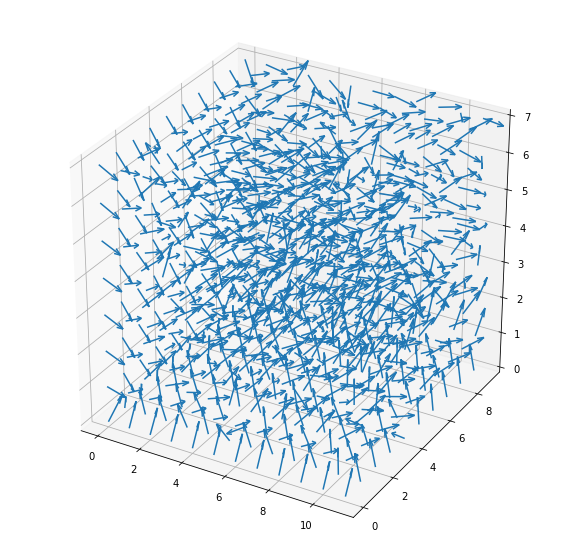

In [ ]:
flow = warp[0, ...]
def meshgridnd_like(in_img,
                    rng_func=range):
    new_shape = list(in_img.shape)
    all_range = [rng_func(i_len) for i_len in new_shape]
    return tuple([x_arr.swapaxes(0, 1) for x_arr in np.meshgrid(*all_range)])
DS_FACTOR = 16
c_xx, c_yy, c_zz = [x.flatten() for x in meshgridnd_like(flow[::DS_FACTOR, ::DS_FACTOR, ::DS_FACTOR, 0])]

get_flow = lambda i: flow[::DS_FACTOR, ::DS_FACTOR, ::DS_FACTOR, i].flatten()

fig = plt.figure(figsize = (10, 10))
ax = fig.gca(projection='3d')

ax.quiver(c_xx, c_yy, c_zz, get_flow(0), get_flow(1),  get_flow(2),  length=0.9, normalize=True)

In [ ]:
flow.shape

(192, 128, 160, 3)

In [ ]:
inp = exgen.__next__()

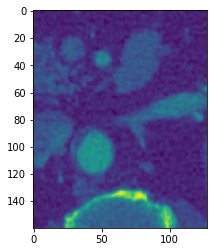

In [ ]:
plt.imshow(inp[0][0][0, 150, ..., 0])

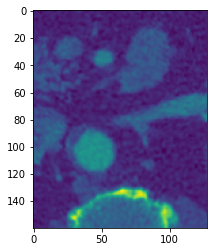

In [ ]:
plt.imshow(inp[1][0][0, 150, ..., 0])

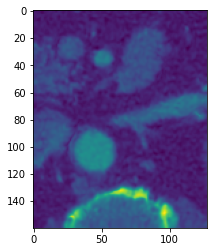

In [ ]:
plt.imshow(res[0][0, 150, ..., 0])

In [ ]:
res[1].shape

(1, 192, 160, 128, 3)

In [ ]:
def plotting(seg, warp):
  len_map = np.sqrt(np.power(warp[0, ..., 0], 2) + np.power(warp[0, ..., 1], 2) + np.power(warp[0, ..., 2], 2))
  len_map[seg < .5] = 0
  return len_map

len_map = plotting(inp[0][2][0, ..., 0], res[1])

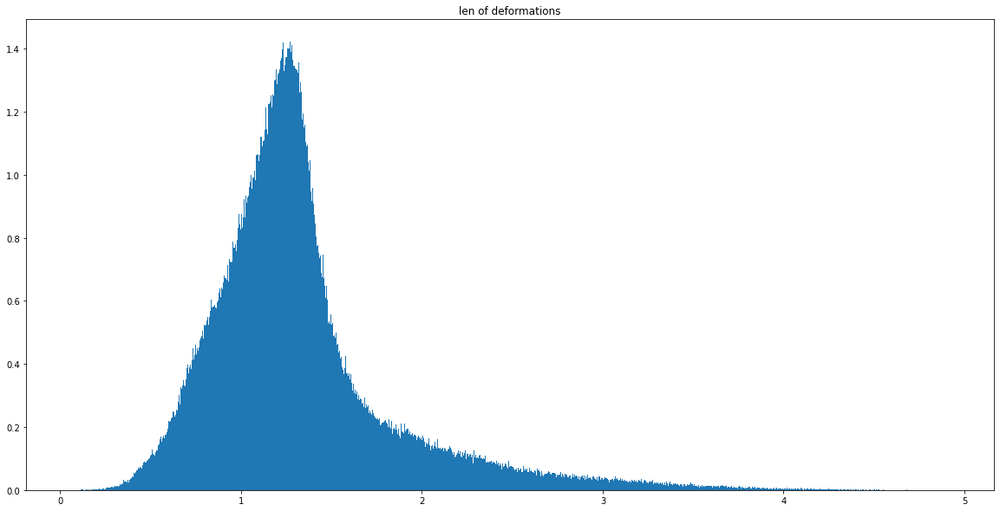

In [ ]:
plt.figure(figsize=(20, 10))
plt.title('len of deformations')
plt.hist(len_map[len_map>0].flatten(), bins=1000, density = True)
plt.show()

In [ ]:
(np.abs(inp[0][2] - inp[1][1]).round()).sum()

66537.0

In [ ]:
(np.abs(res[2].round() - inp[1][1].round())).sum()

40936.0

In [ ]:
np.unique(res[2].round())

array([0., 1.], dtype=float32)

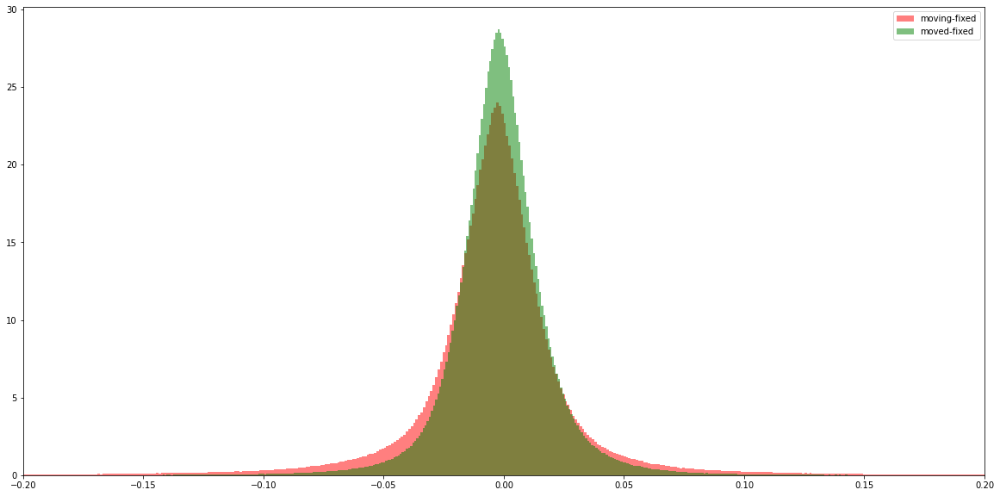

In [ ]:
plt.figure(figsize=(20, 10))
plt.hist((inp[0][0] - inp[0][1]).flatten(), label='moving-fixed', color='r', alpha=0.5, bins=1000, density = True)
plt.hist((res[0] - inp[0][1]).flatten(), label='moved-fixed', color='g', alpha=0.5, bins=1000, density = True)
plt.legend()
plt.xlim(-.2, .2)
plt.show()

In [ ]:
#len_map.sum(axis=(0, 1))[19:-13]
#len_map.sum(axis=(0, 2))[34:-28]

In [ ]:
len_map_cropped = len_map[:, 34:-28, 19:-13]
len_map.shape, len_map_cropped.shape

((192, 160, 128), (192, 98, 96))

In [ ]:
seg_cropped = inp[0][2][0, :, 34:-28, 19:-13, 0]
seg_cropped.shape

(192, 98, 96)

In [ ]:
len_map_cropped(seg_cropped == 1)

411156

In [ ]:
len_map_cropped[seg_cropped > .5] += 3

In [ ]:
(seg_cropped > .5).sum()

411156

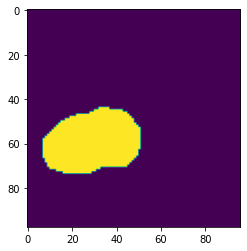

In [ ]:
plt.imshow(seg_cropped[30, ...])

In [ ]:
X, Y, Z = np.mgrid[:192, :98, :96]
fig = go.Figure(data=go.Volume(
    x = X.flatten(),
    y = Y.flatten(),
    z = Z.flatten(),
    value = len_map_cropped.flatten(),
    isomin=0,
    isomax=14,
    opacity = 0.1,
    surface_count = 5,
    ))
fig.show(renderer='colab')

In [ ]:
np.random.seed(0)
l = 130
X, Y, Z = np.mgrid[:l, :l, :l]
vol = np.zeros((l, l, l))
pts = (l * np.random.rand(3, 15)).astype(np.int)
vol[tuple(indices for indices in pts)] = 1
from scipy import ndimage
vol = ndimage.gaussian_filter(vol, 4)
vol /= vol.max()

fig = go.Figure(data=go.Volume(
    x=X.flatten(), y=Y.flatten(), z=Z.flatten(),
    value=vol.flatten(),
    isomin=0.2,
    isomax=0.7,
    opacity=0.1,
    surface_count=5,
    ))
fig.update_layout(scene_xaxis_showticklabels=False,
                  scene_yaxis_showticklabels=False,
                  scene_zaxis_showticklabels=False)
fig.show()

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:5: DeprecationWarning:

`np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations



In [ ]:
from plotly.subplots import make_subplots
fig = make_subplots(
    rows=1, cols=3,
    specs=[[{'type': 'volume'}, {'type': 'volume'}, {'type': 'volume'}]])

In [ ]:
X, Y, Z = np.mgrid[:192, :128, :160]

In [ ]:
def cropper(seg):
  seg_crop = seg[np.sum(seg, axis=(1, 2)) > 0, :, :]
  seg_crop = seg_crop[:, np.sum(seg_crop, axis=(0, 2)) > 0, :]
  seg_crop = seg_crop[:, :, np.sum(seg_crop, axis=(0, 1)) > 0]
  a, b, c = seg_crop.shape
  return (seg_crop, (a, b, c))

In [ ]:
moving_seg, ms_shape = cropper(inp[0][2][0, ..., 0])

In [ ]:
fixed_seg, fs_shape = cropper(inp[1][2][0, ..., 0])

In [ ]:
moved_seg, mds_shape = cropper(res[2][0, ..., 0])

In [ ]:
X, Y, Z = np.mgrid[:ms_shape[0], :ms_shape[1], :ms_shape[2]]


In [ ]:
fig.

(1, 192, 128, 160, 1)

In [ ]:
def preprocess(img_m, img_f):
  img_m = img_m - img_m.min()
  img_f = img_f - img_f.min()

  img_m = img_m.astype('float32') / img_m.max()
  img_f = img_f.astype('float32') / img_f.max()

  return img_m[np.newaxis, ..., np.newaxis], img_f[np.newaxis, ..., np.newaxis]

In [ ]:
def using(model, moving_img, fixed_img, moving_seg):
  Direction = moving_img.GetDirection()
  Origin = moving_img.GetOrigin()
  Spacing = moving_img.GetSpacing()
  img_m = sitk.GetArrayFromImage(moving_img)
  img_f = sitk.GetArrayFromImage(fixed_img)
  seg_m = sitk.GetArrayFromImage(moving_seg)
  seg_m[seg_m > 2] = 0
  seg_m = seg_m.astype('float32')[np.newaxis, ..., np.newaxis]
  img_m, img_f = preprocess(img_m, img_f)

  results = model.predict([img_m, img_f, seg_m])  # [moved_img, warp, moved_seg]
  return results, Direction, Origin, Spacing

In [ ]:
def to_img(arr, Direction, Origin, Spacing):
  img = sitk.GetImageFromArray(arr)
  img.SetDirection(Direction)
  img.SetOrigin(Origin)
  img.SetSpacing(Spacing)
  return img

In [ ]:
len(res)

3

In [ ]:
imagg = sitk.ReadImage('/content/drive/MyDrive/patient_0/img_first.nii.gz')
direction, origin, spacing = imagg.GetDirection(), imagg.GetOrigin(), imagg.GetSpacing()

In [ ]:
moved_imgg = to_img(res[0][0, ..., 0], direction, origin, spacing)

In [ ]:
moved_segg = to_img(res[2][0, ..., 0], direction, origin, spacing)

In [ ]:
warp_what = to_img(res[1][0, ...], direction, origin, spacing)

In [ ]:
warp_what.GetSize()

(160, 128, 192)

In [ ]:
sitk.WriteImage(moved_segg, '/content/drive/MyDrive/patient_0/moveddd.vtk')

In [ ]:
image = sitk.ReadImage('/content/drive/MyDrive/patient_0/label_1.nii.gz')
sitk.WriteImage(image, '/content/drive/MyDrive/patient_0/aboba.vtk')

In [ ]:
import numpy as np

In [ ]:
arr = np.random.rand(50, 50, 50)

array([0.6664081 , 0.66705125, 0.42349654, ..., 0.89833989, 0.39964867,
       0.85590747])